In [ ]:
# This mounts your Google Drive to the Colab VM.
from google.colab import drive
drive.mount('/content/drive')

# TODO: Enter the foldername in your Drive where you have saved the unzipped
# assignment folder, e.g. 'cs231n/assignments/assignment2/'
FOLDERNAME = None
assert FOLDERNAME is not None, "[!] Enter the foldername."

# Now that we've mounted your Drive, this ensures that
# the Python interpreter of the Colab VM can load
# python files from within it.
import sys
sys.path.append('/content/drive/My Drive/{}'.format(FOLDERNAME))

# This downloads the CIFAR-10 dataset to your Drive
# if it doesn't already exist.
%cd /content/drive/My\ Drive/$FOLDERNAME/cs231n/datasets/
!bash get_datasets.sh
%cd /content/drive/My\ Drive/$FOLDERNAME

# Multi-Layer Fully Connected Network
In this exercise, you will implement a fully connected network with an arbitrary number of hidden layers.

Read through the `FullyConnectedNet` class in the file `cs231n/classifiers/fc_net.py`.

Implement the network initialization, forward pass, and backward pass. Throughout this assignment, you will be implementing layers in `cs231n/layers.py`. You can re-use your implementations for `affine_forward`, `affine_backward`, `relu_forward`, `relu_backward`, and `softmax_loss` from Assignment 1. For right now, don't worry about implementing dropout or batch/layer normalization yet, as you will add those features later.


In [1]:
# Setup cell.
import time
import numpy as np
import matplotlib.pyplot as plt
from cs231n.classifiers.fc_net import *
from cs231n.data_utils import get_CIFAR10_data
from cs231n.gradient_check import eval_numerical_gradient, eval_numerical_gradient_array
from cs231n.solver import Solver

%matplotlib inline
plt.rcParams["figure.figsize"] = (10.0, 8.0)  # Set default size of plots.
plt.rcParams["image.interpolation"] = "nearest"
plt.rcParams["image.cmap"] = "gray"

%load_ext autoreload
%autoreload 2

def rel_error(x, y):
    """Returns relative error."""
    return np.max(np.abs(x - y) / (np.maximum(1e-8, np.abs(x) + np.abs(y))))

=========== You can safely ignore the message below if you are NOT working on ConvolutionalNetworks.ipynb ===========
	You will need to compile a Cython extension for a portion of this assignment.
	The instructions to do this will be given in a section of the notebook below.


In [2]:
# Load the (preprocessed) CIFAR-10 data.
data = get_CIFAR10_data()
for k, v in list(data.items()):
    print(f"{k}: {v.shape}")

X_train: (49000, 3, 32, 32)
y_train: (49000,)
X_val: (1000, 3, 32, 32)
y_val: (1000,)
X_test: (1000, 3, 32, 32)
y_test: (1000,)


## Initial Loss and Gradient Check

As a sanity check, run the following to check the initial loss and to gradient check the network both with and without regularization. This is a good way to see if the initial losses seem reasonable.

For gradient checking, you should expect to see errors around 1e-7 or less.

In [3]:
np.random.seed(231)
N, D, H1, H2, C = 2, 15, 20, 30, 10
X = np.random.randn(N, D)
y = np.random.randint(C, size=(N,))


for reg in [0, 3.14]:
    print("Running check with reg = ", reg)
    model = FullyConnectedNet(
        [H1, H2],
        input_dim=D,
        num_classes=C,
        reg=reg,
        weight_scale=5e-2,
        dtype=np.float64
    )

    loss, grads = model.loss(X, y)
    print("Initial loss: ", loss)

    # Most of the errors should be on the order of e-7 or smaller.   
    # NOTE: It is fine however to see an error for W2 on the order of e-5
    # for the check when reg = 0.0
    for name in sorted(grads):
        f = lambda _: model.loss(X, y)[0]
        grad_num = eval_numerical_gradient(f, model.params[name], verbose=False, h=1e-5)
        print(f"{name} relative error: {rel_error(grad_num, grads[name])}")

Running check with reg =  0
Initial loss:  2.300479089768492
W1 relative error: 1.0252674471656573e-07
W2 relative error: 2.2120479295080622e-05
W3 relative error: 4.5623278736665505e-07
b1 relative error: 4.6600944653202505e-09
b2 relative error: 2.085654276112763e-09
b3 relative error: 1.689724888469736e-10
Running check with reg =  3.14
Initial loss:  7.052114776533016
W1 relative error: 3.904541941902138e-09
W2 relative error: 6.86942277940646e-08
W3 relative error: 3.483989247437803e-08
b1 relative error: 1.4752427965311745e-08
b2 relative error: 1.4615869332918208e-09
b3 relative error: 1.3200479211447775e-10


As another sanity check, make sure your network can overfit on a small dataset of 50 images. First, we will try a three-layer network with 100 units in each hidden layer. In the following cell, tweak the **learning rate** and **weight initialization scale** to overfit and achieve 100% training accuracy within 20 epochs.

(Iteration 1 / 40) loss: 2.363364
Input shape:  (50, 3, 32, 32)
[[ 4.51251750e-02  6.32281721e-02 -9.89011387e-02  2.10326692e-01
   3.87594704e-02  1.83539774e-02  4.80293594e-02  4.80099466e-02
  -1.22087070e-02  3.39926989e-01]
 [ 1.80304835e-01  6.61245021e-02 -2.75043079e-01  3.07486380e-01
   1.98256412e-01 -2.32034975e-02  5.31546961e-02  6.42782890e-02
  -2.77375808e-01  7.00122607e-02]
 [ 3.35896438e-01 -5.38806664e-02 -4.31035800e-01  6.83499267e-02
  -2.24475575e-01  1.75043940e-01 -2.30398940e-01  5.90593593e-03
   7.98401586e-02  2.97735984e-01]
 [ 6.72834513e-03  2.82432180e-02 -4.86907017e-02  9.35219374e-02
  -5.36155625e-02  1.22197364e-01 -3.11039105e-02 -5.43538484e-02
  -1.96482678e-01  3.73183320e-01]
 [ 1.33764851e-01 -5.36853604e-02 -3.61108721e-01  1.34417280e-01
  -2.59897804e-01 -6.22536580e-02 -5.98044580e-02 -9.64404475e-02
  -2.11675481e-01  3.59333701e-01]
 [ 7.30960300e-03  3.67066679e-02 -1.16331952e-01  3.94319555e-01
   1.08450295e-01 -1.85772436e-02 -

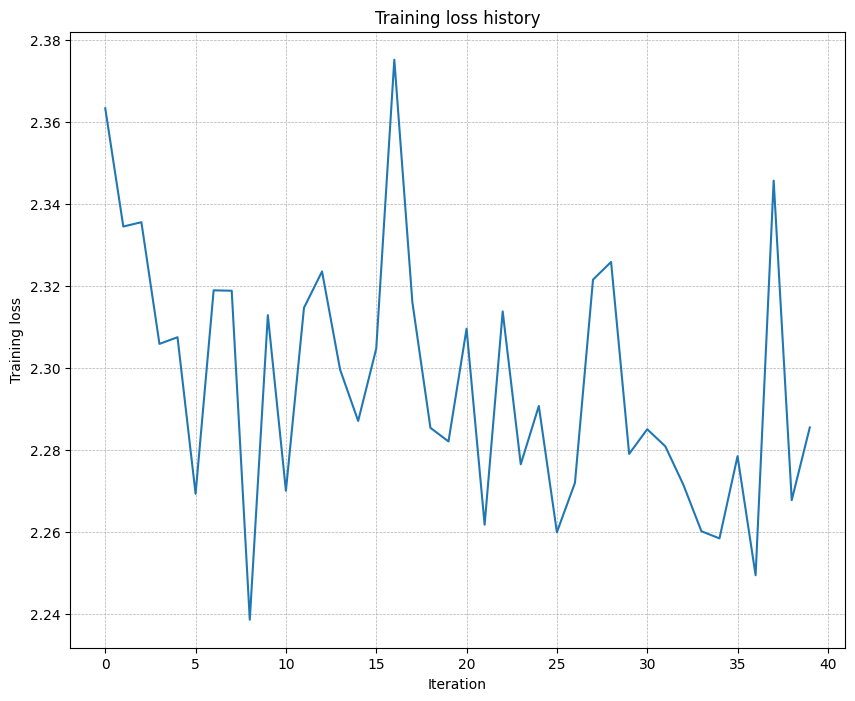

In [4]:
# TODO: Use a three-layer Net to overfit 50 training examples by 
# tweaking just the learning rate and initialization scale.

num_train = 50
small_data = {
  "X_train": data["X_train"][:num_train],
  "y_train": data["y_train"][:num_train],
  "X_val": data["X_val"],
  "y_val": data["y_val"],
}

weight_scale = 1e-2   # Experiment with this!
learning_rate = 1e-4  # Experiment with this!
model = FullyConnectedNet(
    [100, 100],
    weight_scale=weight_scale,
    dtype=np.float64
)
solver = Solver(
    model,
    small_data,
    print_every=10,
    num_epochs=20,
    batch_size=25,
    update_rule="sgd",
    optim_config={"learning_rate": learning_rate},
)
solver.train()

plt.plot(solver.loss_history)
plt.title("Training loss history")
plt.xlabel("Iteration")
plt.ylabel("Training loss")
plt.grid(linestyle='--', linewidth=0.5)
plt.show()

Now, try to use a five-layer network with 100 units on each layer to overfit on 50 training examples. Again, you will have to adjust the learning rate and weight initialization scale, but you should be able to achieve 100% training accuracy within 20 epochs.

(Iteration 1 / 40) loss: 2.302585
Input shape:  (50, 3, 32, 32)
[[ 4.00000002e-05  1.20000000e-04  2.00000000e-04 -3.99999999e-05
   1.20000000e-04 -2.00000001e-04 -1.20000000e-04 -4.00000002e-05
  -2.00000000e-04  1.20000000e-04]
 [ 4.00000002e-05  1.20000000e-04  2.00000000e-04 -3.99999999e-05
   1.20000000e-04 -2.00000001e-04 -1.20000000e-04 -4.00000002e-05
  -2.00000000e-04  1.20000000e-04]
 [ 4.00000002e-05  1.20000000e-04  2.00000000e-04 -3.99999999e-05
   1.20000000e-04 -2.00000001e-04 -1.20000000e-04 -4.00000002e-05
  -2.00000000e-04  1.20000000e-04]
 [ 4.00000002e-05  1.20000000e-04  2.00000000e-04 -3.99999999e-05
   1.20000000e-04 -2.00000001e-04 -1.20000000e-04 -4.00000002e-05
  -2.00000000e-04  1.20000000e-04]
 [ 4.00000002e-05  1.20000000e-04  2.00000000e-04 -3.99999999e-05
   1.20000000e-04 -2.00000001e-04 -1.20000000e-04 -4.00000002e-05
  -2.00000000e-04  1.20000000e-04]
 [ 4.00000002e-05  1.20000000e-04  2.00000000e-04 -3.99999999e-05
   1.20000000e-04 -2.00000001e-04 -

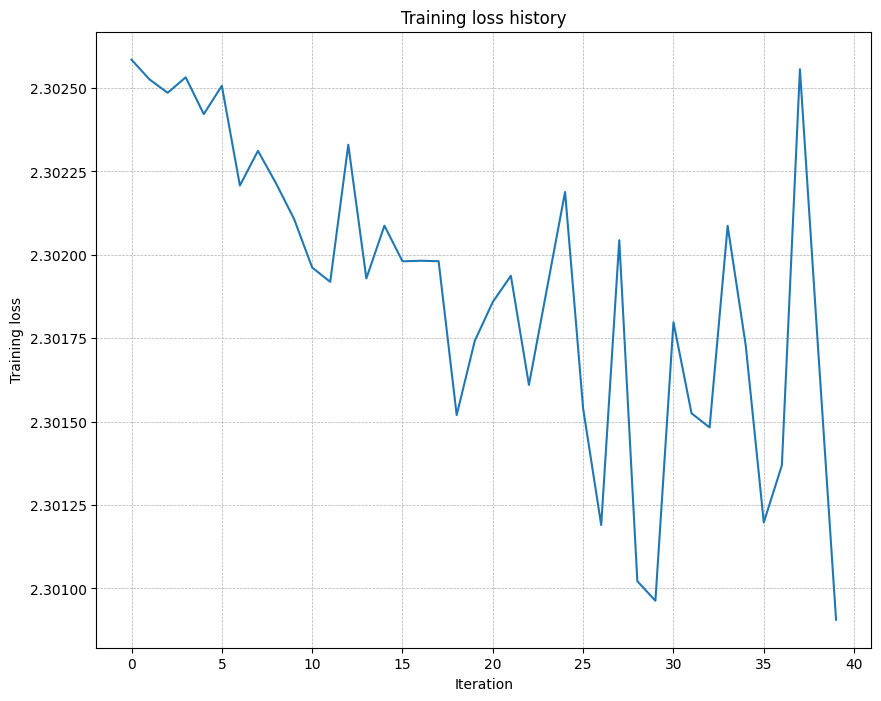

In [5]:
# TODO: Use a five-layer Net to overfit 50 training examples by 
# tweaking just the learning rate and initialization scale.

num_train = 50
small_data = {
  'X_train': data['X_train'][:num_train],
  'y_train': data['y_train'][:num_train],
  'X_val': data['X_val'],
  'y_val': data['y_val'],
}

learning_rate = 2e-3  # Experiment with this!
weight_scale = 1e-5   # Experiment with this!
model = FullyConnectedNet(
    [100, 100, 100, 100],
    weight_scale=weight_scale,
    dtype=np.float64
)
solver = Solver(
    model,
    small_data,
    print_every=10,
    num_epochs=20,
    batch_size=25,
    update_rule='sgd',
    optim_config={'learning_rate': learning_rate},
)
solver.train()

plt.plot(solver.loss_history)
plt.title('Training loss history')
plt.xlabel('Iteration')
plt.ylabel('Training loss')
plt.grid(linestyle='--', linewidth=0.5)
plt.show()

## Inline Question 1: 
Did you notice anything about the comparative difficulty of training the three-layer network vs. training the five-layer network? In particular, based on your experience, which network seemed more sensitive to the initialization scale? Why do you think that is the case?

## Answer:
When comparing the training difficuty of the three-layer network with the five-layer netwrok, it became apparent that the five-layer network was more sensitive to the initialization scale of its weights. This is primarily due to increased depth of the network, which introduces challenges related to gradient propagation.

The five-layer network exhibited greater sensitivity to initializatioin because as the depth of network increases, the issues of `vanishing gradients and exploding gradients` become more pronounced. In deeper networks, gradients must be propagated through more layers during backpropagation, and if the weight initialization is not appropriate, these gradients can either shrink to very small values or grow uncontrollably. This leads to poor convergence or instability during training.

In contrast, the three-layer network was less sensitive to initialization scale. Since the network is shallower, the gradients do not have to travel through as many layers, which mitigates the effects of vanishing and exploding gradients. This made training more stable and less dependent on the weight initialization, allowing the model to converge even if the initializatioin wasn't perfect.

The sensitivity difference between the two networks is attributed to the following factors:
- Gradient propagation: In deeper networks, gradients are propagated through more layers, increasing the risk of them becoming too small or too large. This makes deeper network more sensitive to weight scaling.

- Weight Scaling: Improper scaling of weights in deeper networks can lead to issues with gradient magnitude, which can impede the learning process. Shallow networks are less effected by this because the gradients have a shorter path to propagate through.

In conclusion, deeper networks, such as the five-layer network, are more sensitive to the scale of weight initialization due to the complexities of gradient propagation. Shallow networks, like the three-layer network, tend to be less sensitive and are more forgiving with regard to initialization, making them easier to train.



# Update rules
So far we have used vanilla stochastic gradient descent (SGD) as our update rule. More sophisticated update rules can make it easier to train deep networks. We will implement a few of the most commonly used update rules and compare them to vanilla SGD.

## SGD+Momentum
Stochastic gradient descent with momentum is a widely used update rule that tends to make deep networks converge faster than vanilla stochastic gradient descent. See the Momentum Update section at http://cs231n.github.io/neural-networks-3/#sgd for more information.

Open the file `cs231n/optim.py` and read the documentation at the top of the file to make sure you understand the API. Implement the SGD+momentum update rule in the function `sgd_momentum` and run the following to check your implementation. You should see errors less than e-8.

In [6]:
from cs231n.optim import sgd_momentum

N, D = 4, 5
w = np.linspace(-0.4, 0.6, num=N*D).reshape(N, D)
dw = np.linspace(-0.6, 0.4, num=N*D).reshape(N, D)
v = np.linspace(0.6, 0.9, num=N*D).reshape(N, D)

config = {"learning_rate": 1e-3, "velocity": v}
next_w, _ = sgd_momentum(w, dw, config=config)

expected_next_w = np.asarray([
  [ 0.1406,      0.20738947,  0.27417895,  0.34096842,  0.40775789],
  [ 0.47454737,  0.54133684,  0.60812632,  0.67491579,  0.74170526],
  [ 0.80849474,  0.87528421,  0.94207368,  1.00886316,  1.07565263],
  [ 1.14244211,  1.20923158,  1.27602105,  1.34281053,  1.4096    ]])
expected_velocity = np.asarray([
  [ 0.5406,      0.55475789,  0.56891579, 0.58307368,  0.59723158],
  [ 0.61138947,  0.62554737,  0.63970526,  0.65386316,  0.66802105],
  [ 0.68217895,  0.69633684,  0.71049474,  0.72465263,  0.73881053],
  [ 0.75296842,  0.76712632,  0.78128421,  0.79544211,  0.8096    ]])

# Should see relative errors around e-8 or less
print("next_w error: ", rel_error(next_w, expected_next_w))
print("velocity error: ", rel_error(expected_velocity, config["velocity"]))

next_w error:  8.882347033505819e-09
velocity error:  4.269287743278663e-09


Once you have done so, run the following to train a six-layer network with both SGD and SGD+momentum. You should see the SGD+momentum update rule converge faster.

Running with  sgd
(Iteration 1 / 200) loss: 2.559978
Input shape:  (100, 3, 32, 32)
[[-3.08988512e-01 -9.10375938e-02 -4.10047323e-02  3.68791133e-01
  -1.97781876e-01 -1.82185292e-01 -3.13116550e-01 -2.58152664e-01
   3.38389695e-01  2.80940324e-01]
 [ 9.40237463e-01  2.35321417e-01  1.93153024e-01  6.36227906e-01
  -3.42599779e-01 -7.76704073e-01 -8.62737671e-02 -5.42702265e-02
   5.02476811e-01 -6.84065223e-02]
 [ 3.25330675e-01 -1.23051155e+00  1.27450764e-01  8.04370642e-01
  -2.69261408e+00 -2.02644563e+00 -1.03901386e+00  3.64448726e-02
   1.40850747e+00  1.43426371e+00]
 [ 2.70367265e-01 -5.71077652e-02  5.01341105e-01  8.24916601e-01
  -6.06232464e-01 -1.57560766e-01 -8.46501887e-01  4.02264670e-02
   6.61848128e-01  9.26209807e-01]
 [ 1.76944107e-01 -6.73659325e-01  3.95575792e-01  5.16236305e-01
  -8.89585838e-02 -7.42617771e-02 -8.97923887e-01 -1.41650110e-01
   1.13164020e+00 -8.42902809e-02]
 [ 1.30419457e+00 -1.47191870e+00  8.19339335e-01  1.13672113e+00
  -7.99458802e-

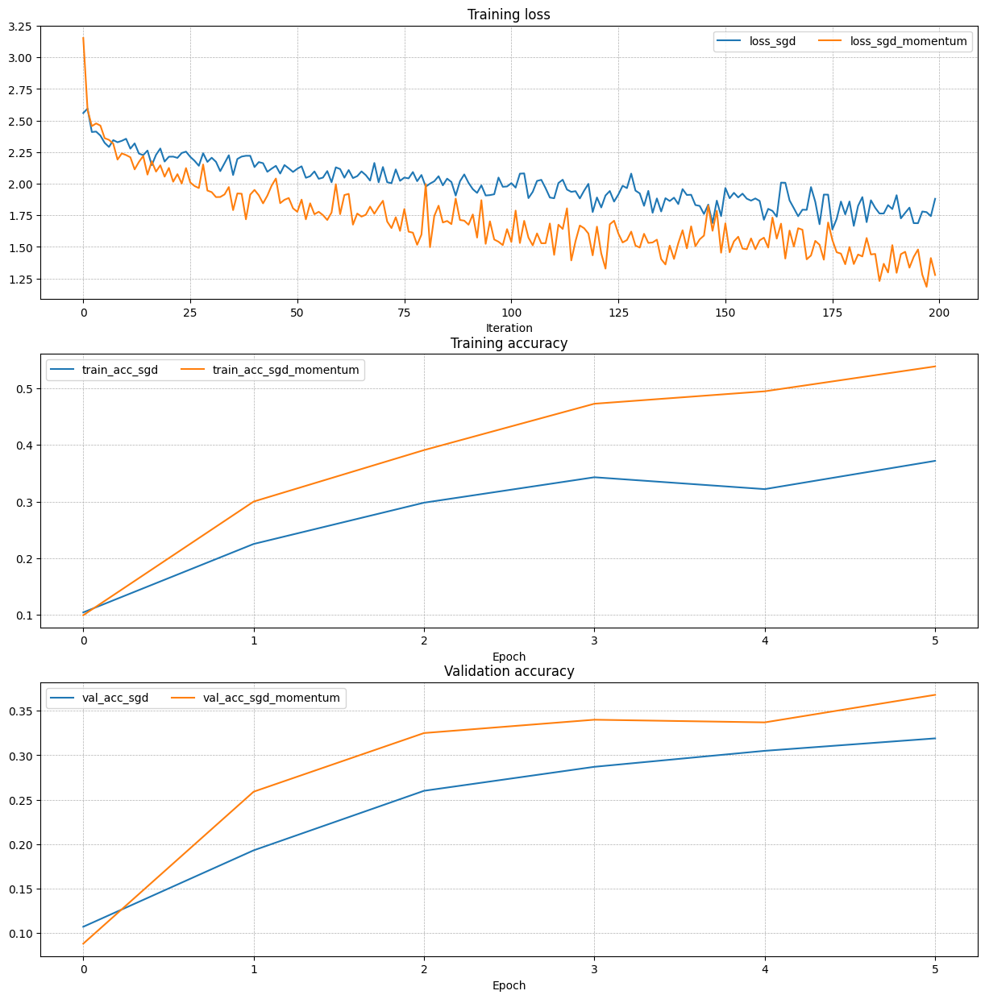

In [7]:
num_train = 4000
small_data = {
  'X_train': data['X_train'][:num_train],
  'y_train': data['y_train'][:num_train],
  'X_val': data['X_val'],
  'y_val': data['y_val'],
}

solvers = {}

for update_rule in ['sgd', 'sgd_momentum']:
    print('Running with ', update_rule)
    model = FullyConnectedNet(
        [100, 100, 100, 100, 100],
        weight_scale=5e-2
    )

    solver = Solver(
        model,
        small_data,
        num_epochs=5,
        batch_size=100,
        update_rule=update_rule,
        optim_config={'learning_rate': 5e-3},
        verbose=True,
    )
    solvers[update_rule] = solver
    solver.train()

fig, axes = plt.subplots(3, 1, figsize=(15, 15))

axes[0].set_title('Training loss')
axes[0].set_xlabel('Iteration')
axes[1].set_title('Training accuracy')
axes[1].set_xlabel('Epoch')
axes[2].set_title('Validation accuracy')
axes[2].set_xlabel('Epoch')

for update_rule, solver in solvers.items():
    axes[0].plot(solver.loss_history, label=f"loss_{update_rule}")
    axes[1].plot(solver.train_acc_history, label=f"train_acc_{update_rule}")
    axes[2].plot(solver.val_acc_history, label=f"val_acc_{update_rule}")
    
for ax in axes:
    ax.legend(loc="best", ncol=4)
    ax.grid(linestyle='--', linewidth=0.5)

plt.show()

## RMSProp and Adam
RMSProp [1] and Adam [2] are update rules that set per-parameter learning rates by using a running average of the second moments of gradients.

In the file `cs231n/optim.py`, implement the RMSProp update rule in the `rmsprop` function and implement the Adam update rule in the `adam` function, and check your implementations using the tests below.

**NOTE:** Please implement the _complete_ Adam update rule (with the bias correction mechanism), not the first simplified version mentioned in the course notes. 

[1] Tijmen Tieleman and Geoffrey Hinton. "Lecture 6.5-rmsprop: Divide the gradient by a running average of its recent magnitude." COURSERA: Neural Networks for Machine Learning 4 (2012).

[2] Diederik Kingma and Jimmy Ba, "Adam: A Method for Stochastic Optimization", ICLR 2015.

In [8]:
# Test RMSProp implementation
from cs231n.optim import rmsprop

N, D = 4, 5
w = np.linspace(-0.4, 0.6, num=N*D).reshape(N, D)
dw = np.linspace(-0.6, 0.4, num=N*D).reshape(N, D)
cache = np.linspace(0.6, 0.9, num=N*D).reshape(N, D)

config = {'learning_rate': 1e-2, 'cache': cache}
next_w, _ = rmsprop(w, dw, config=config)

expected_next_w = np.asarray([
  [-0.39223849, -0.34037513, -0.28849239, -0.23659121, -0.18467247],
  [-0.132737,   -0.08078555, -0.02881884,  0.02316247,  0.07515774],
  [ 0.12716641,  0.17918792,  0.23122175,  0.28326742,  0.33532447],
  [ 0.38739248,  0.43947102,  0.49155973,  0.54365823,  0.59576619]])
expected_cache = np.asarray([
  [ 0.5976,      0.6126277,   0.6277108,   0.64284931,  0.65804321],
  [ 0.67329252,  0.68859723,  0.70395734,  0.71937285,  0.73484377],
  [ 0.75037008,  0.7659518,   0.78158892,  0.79728144,  0.81302936],
  [ 0.82883269,  0.84469141,  0.86060554,  0.87657507,  0.8926    ]])

# You should see relative errors around e-7 or less
print('next_w error: ', rel_error(expected_next_w, next_w))
print('cache error: ', rel_error(expected_cache, config['cache']))

next_w error:  9.524687511038133e-08
cache error:  2.6477955807156126e-09


In [9]:
# Test Adam implementation
from cs231n.optim import adam

N, D = 4, 5
w = np.linspace(-0.4, 0.6, num=N*D).reshape(N, D)
dw = np.linspace(-0.6, 0.4, num=N*D).reshape(N, D)
m = np.linspace(0.6, 0.9, num=N*D).reshape(N, D)
v = np.linspace(0.7, 0.5, num=N*D).reshape(N, D)

config = {'learning_rate': 1e-2, 'm': m, 'v': v, 't': 5}
next_w, _ = adam(w, dw, config=config)

expected_next_w = np.asarray([
  [-0.40094747, -0.34836187, -0.29577703, -0.24319299, -0.19060977],
  [-0.1380274,  -0.08544591, -0.03286534,  0.01971428,  0.0722929],
  [ 0.1248705,   0.17744702,  0.23002243,  0.28259667,  0.33516969],
  [ 0.38774145,  0.44031188,  0.49288093,  0.54544852,  0.59801459]])
expected_v = np.asarray([
  [ 0.69966,     0.68908382,  0.67851319,  0.66794809,  0.65738853,],
  [ 0.64683452,  0.63628604,  0.6257431,   0.61520571,  0.60467385,],
  [ 0.59414753,  0.58362676,  0.57311152,  0.56260183,  0.55209767,],
  [ 0.54159906,  0.53110598,  0.52061845,  0.51013645,  0.49966,   ]])
expected_m = np.asarray([
  [ 0.48,        0.49947368,  0.51894737,  0.53842105,  0.55789474],
  [ 0.57736842,  0.59684211,  0.61631579,  0.63578947,  0.65526316],
  [ 0.67473684,  0.69421053,  0.71368421,  0.73315789,  0.75263158],
  [ 0.77210526,  0.79157895,  0.81105263,  0.83052632,  0.85      ]])

# You should see relative errors around e-7 or less
print('next_w error: ', rel_error(expected_next_w, next_w))
print('v error: ', rel_error(expected_v, config['v']))
print('m error: ', rel_error(expected_m, config['m']))

next_w error:  1.1395691798535431e-07
v error:  4.208314038113071e-09
m error:  4.214963193114416e-09


Once you have debugged your RMSProp and Adam implementations, run the following to train a pair of deep networks using these new update rules:

Running with  adam
(Iteration 1 / 200) loss: 3.476928
Input shape:  (100, 3, 32, 32)
[[ 5.66668570e-01 -7.09012032e-01  6.01901829e-01  2.98555404e-01
  -4.39831726e-02  2.55146086e-01  3.18544626e-01 -2.93650031e-01
  -2.22879633e-01 -2.78287143e-01]
 [ 6.88279152e-01  6.87049404e-02 -7.75152862e-01  7.52380729e-01
  -8.45141411e-01  4.44802731e-01 -3.28242213e-01 -5.40792160e-02
  -6.83776364e-02  8.61165702e-01]
 [-7.26177454e-01  5.22256434e-01  1.02780843e+00 -5.16080260e-01
   1.42813586e-02  4.19682860e-01  7.69704044e-01  5.56468666e-01
   2.63054855e-02 -6.06384277e-01]
 [-5.97379357e-02 -2.16699049e-01  5.42788088e-01  1.83221668e-01
  -1.42631512e-02 -7.18879700e-01  4.17493105e-01  6.72447264e-01
   3.05352956e-01  3.46243769e-01]
 [-1.63281988e-02 -1.05425394e+00  4.98615474e-01  7.43980825e-01
  -5.97806096e-01  1.35205314e-01  7.05308914e-01  1.10803318e+00
  -6.33869886e-01  8.24124217e-01]
 [ 1.82973132e-01  3.32151324e-01  4.06629622e-01  9.01353955e-02
  -7.55409971e

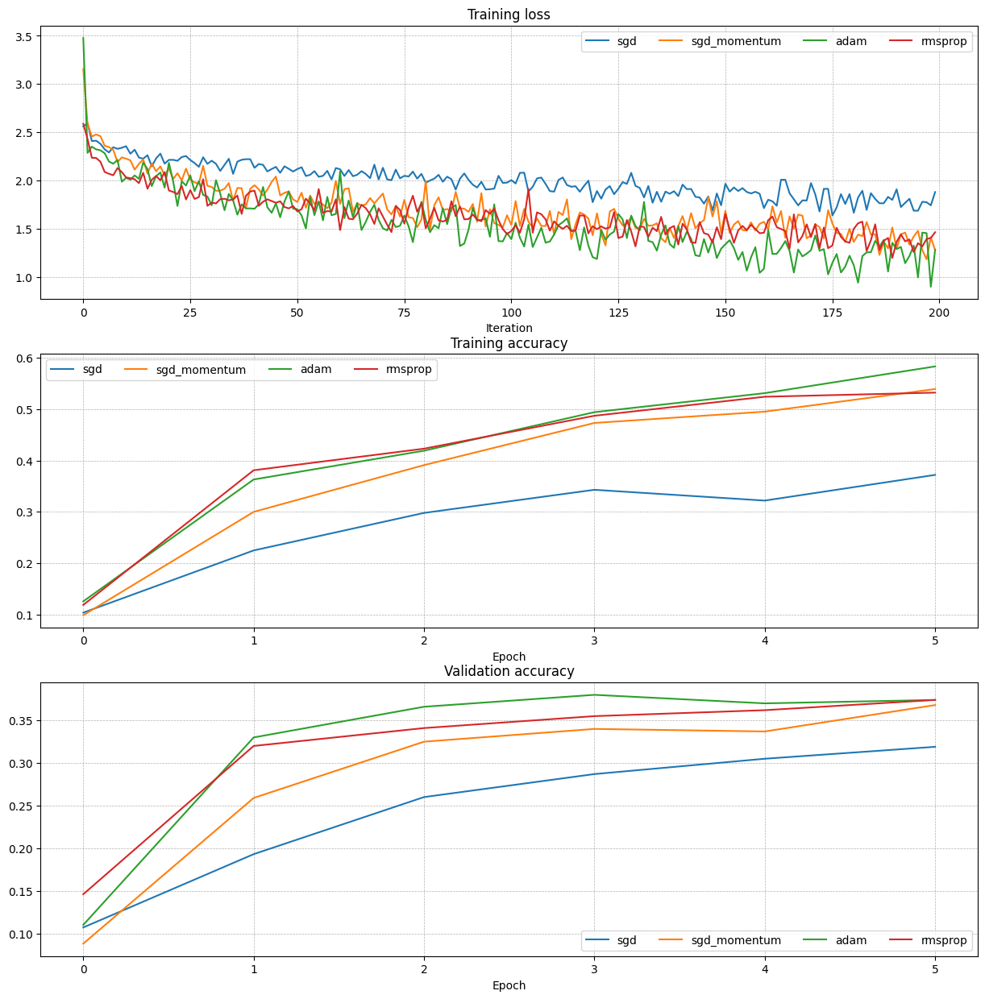

In [10]:
learning_rates = {'rmsprop': 1e-4, 'adam': 1e-3}
for update_rule in ['adam', 'rmsprop']:
    print('Running with ', update_rule)
    model = FullyConnectedNet(
        [100, 100, 100, 100, 100],
        weight_scale=5e-2
    )
    solver = Solver(
        model,
        small_data,
        num_epochs=5,
        batch_size=100,
        update_rule=update_rule,
        optim_config={'learning_rate': learning_rates[update_rule]},
        verbose=True
    )
    solvers[update_rule] = solver
    solver.train()
    print()
    
fig, axes = plt.subplots(3, 1, figsize=(15, 15))

axes[0].set_title('Training loss')
axes[0].set_xlabel('Iteration')
axes[1].set_title('Training accuracy')
axes[1].set_xlabel('Epoch')
axes[2].set_title('Validation accuracy')
axes[2].set_xlabel('Epoch')

for update_rule, solver in solvers.items():
    axes[0].plot(solver.loss_history, label=f"{update_rule}")
    axes[1].plot(solver.train_acc_history, label=f"{update_rule}")
    axes[2].plot(solver.val_acc_history, label=f"{update_rule}")
    
for ax in axes:
    ax.legend(loc='best', ncol=4)
    ax.grid(linestyle='--', linewidth=0.5)

plt.show()

## Inline Question 2:

AdaGrad, like Adam, is a per-parameter optimization method that uses the following update rule:

```
cache += dw**2
w += - learning_rate * dw / (np.sqrt(cache) + eps)
```

John notices that when he was training a network with AdaGrad that the updates became very small, and that his network was learning slowly. Using your knowledge of the AdaGrad update rule, why do you think the updates would become very small? Would Adam have the same issue?


## Answer: 
The cache accumulates the squared gradients over time. This means that as training progresses and the network learns, the denominator in the update rule (np.sqrt(cache)) becomes larger. The accumulation of squared gradients in cache grows as each weight's gradient is squared and added up, which causes the update magnitude to decrease over time. Eventually, this leads to very small updates, especially if the gradients have been accumulated over many iterations.

Why do the updates become very small?
As training continues, the value of the cache increases, which increases the denominator of the update rule. This causes the overall update size to shrink over time, even if the gradients dw themselves are still substantial. This behavior leads to an issue where the network’s learning slows down significantly as the parameter updates get smaller and smaller, especially if the training process involves many iterations.

Would Adam have the same issue?
No, Adam would not have the same issue as AdaGrad. Adam combines the benefits of both momentum (through the moving average of the gradients) and AdaGrad (through the moving average of squared gradients). Adam uses two momentums:

The first moment (the moving average of the gradients).

The second moment (the moving average of squared gradients).

```Adam’s update rule is:
m = beta1 * m + (1 - beta1) * dw
v = beta2 * v + (1 - beta2) * dw**2
w += - learning_rate * m / (np.sqrt(v) + eps)```

While Adam still uses a form of per-parameter learning rate adjustment (like AdaGrad), it avoids the shrinking update problem because it normalizes the squared gradients using a moving average rather than an accumulating sum. This allows Adam to continue making effective updates over time, even after many iterations, by mitigating the problem of excessively small updates. Additionally, Adam's use of momentum helps prevent the optimization from getting stuck due to small updates.

Thus, while AdaGrad tends to slow down due to large accumulated squared gradients, Adam maintains more stable and consistent updates throughout training, avoiding this issue.

# Train a Good Model!
Train the best fully connected model that you can on CIFAR-10, storing your best model in the `best_model` variable. We require you to get at least 50% accuracy on the validation set using a fully connected network.

If you are careful it should be possible to get accuracies above 55%, but we don't require it for this part and won't assign extra credit for doing so. Later in the assignment we will ask you to train the best convolutional network that you can on CIFAR-10, and we would prefer that you spend your effort working on convolutional networks rather than fully connected networks.

**Note:** You might find it useful to complete the `BatchNormalization.ipynb` and `Dropout.ipynb` notebooks before completing this part, since those techniques can help you train powerful models.

In [17]:
best_model = None

################################################################################
# TODO: Train the best FullyConnectedNet that you can on CIFAR-10. You might   #
# find batch/layer normalization and dropout useful. Store your best model in  #
# the best_model variable.                                                     #
################################################################################
# *****START OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
import sys
sys.path.append('./cs231n')  # Add cs231n to the path
from solver import Solver  # Make sure Solver is correctly implemented
from cs231n.classifiers.fc_net import FullyConnectedNet

# Define the architecture for your fully connected model
best_model = FullyConnectedNet(
    hidden_dims=[200, 200],  # Example: Two hidden layers with 100 neurons each
    input_dim=3072,  # CIFAR-10 images are 32x32x3 = 3072
    num_classes=10,
    weight_scale=1e-2,  # Good initial weight scale
    reg=0.1,  # L2 regularization strength
    dtype=np.float32
)

# Set up the solver
solver = Solver(
    best_model, 
    data,  # Use the preloaded CIFAR-10 dataset
    update_rule="adam",  # Adam optimizer
    optim_config={"learning_rate": 1e-3},  # Start with a good LR
    lr_decay=0.95,  # Reduce learning rate over epochs
    num_epochs=30,  # Train long enough
    batch_size=128, 
    print_every=100,  # Adjust based on your training speed
    verbose=True
)

# Train the model
solver.train()
# *****END OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
################################################################################
#                              END OF YOUR CODE                                #
################################################################################

(Iteration 1 / 11460) loss: 5.601694
Input shape:  (100, 3, 32, 32)
[[-2.30623531e+00 -8.53884146e-02  7.75123537e-01 -5.99911332e-01
   3.31666207e+00  2.62918162e+00  2.42294025e+00  1.33026862e+00
  -2.53135538e+00 -1.72107220e+00]
 [-1.11250162e+00  8.64565074e-01  8.75579953e-01 -1.24700475e+00
   1.54341245e+00  1.11223340e+00  1.00041533e+00  2.23425046e-01
  -5.58946133e-01 -2.41336417e+00]
 [ 2.82830354e-02 -6.63170338e-01 -1.53204775e+00 -1.98843706e+00
  -1.48250568e+00  1.74027339e-01 -6.14709973e-01 -6.86432302e-01
   3.29355216e+00 -3.45278740e-01]
 [-1.47785985e+00  9.86874163e-01 -5.88432074e-01 -2.67108107e+00
  -1.34649098e+00 -1.90971628e-01 -3.11452359e-01  8.14365089e-01
   3.82313204e+00 -4.80778441e-02]
 [-3.71695876e-01 -2.51811117e-01 -7.82686174e-01 -1.54024935e+00
  -1.16673028e+00  1.22509129e-01  2.20116600e-01 -4.76890713e-01
   2.43375802e+00 -2.09930167e-01]
 [-1.29712212e+00 -4.60364282e-01  4.68329102e-01 -1.10306430e+00
   5.69181383e-01  2.11224193e-

# Test Your Model!
Run your best model on the validation and test sets. You should achieve at least 50% accuracy on the validation set.

In [18]:
y_test_pred = np.argmax(best_model.loss(data['X_test']), axis=1)
y_val_pred = np.argmax(best_model.loss(data['X_val']), axis=1)
print('Validation set accuracy: ', (y_val_pred == data['y_val']).mean())
print('Test set accuracy: ', (y_test_pred == data['y_test']).mean())

Validation set accuracy:  0.495
Test set accuracy:  0.476
